In [34]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import anderson
from sklearn.preprocessing import MultiLabelBinarizer
from ydata_profiling import ProfileReport
%matplotlib inline

# Exploración de datos

## Importación de los datos

In [35]:
white_wine = pd.read_csv('winequality-white.csv', sep=';')
red_wine = pd.read_csv('winequality-red.csv', sep=';')

In [36]:
white_wine.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


In [37]:
red_wine.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


## Análisis exploratorio

In [38]:
profile = ProfileReport(white_wine, title='White Wine Profiling Report', explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [39]:
profile = ProfileReport(red_wine, title='Red Wine Profiling Report', explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Procesamiento de datos

Debido a que los datos se encuentran en dos conjuntos, uno para vinos blancos y uno para vinos rojos, se procederá a unirlos en uno solo

In [40]:
white_wine['type'] = 'white'
red_wine['type'] = 'red'
wines = pd.concat([white_wine, red_wine], axis=0)
wines.head(10)

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,white
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,white
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,white
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,white
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,white
5,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,white
6,6.2,0.32,0.16,7.0,0.045,30.0,136.0,0.9949,3.18,0.47,9.6,6,white
7,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,white
8,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,white
9,8.1,0.22,0.43,1.5,0.044,28.0,129.0,0.9938,3.22,0.45,11.0,6,white


### Verificar si hay valores nulos

In [41]:
wines.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
type                    0
dtype: int64

In [42]:
profile = ProfileReport(wines, title='Wines Profiling Report', explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [43]:
wines.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000,6497.000000
mean,7.215307,0.339666,0.318633,5.443235,0.056034,30.525319,115.744574,0.994697,3.218501,0.531268,10.491801,5.818378
std,1.296434,0.164636,0.145318,4.757804,0.035034,17.749400,56.521855,0.002999,0.160787,0.148806,1.192712,0.873255
min,3.800000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.400000,0.230000,0.250000,1.800000,0.038000,17.000000,77.000000,0.992340,3.110000,0.430000,9.500000,5.000000
50%,7.000000,0.290000,0.310000,3.000000,0.047000,29.000000,118.000000,0.994890,3.210000,0.510000,10.300000,6.000000
75%,7.700000,0.400000,0.390000,8.100000,0.065000,41.000000,156.000000,0.996990,3.320000,0.600000,11.300000,6.000000
max,15.900000,1.580000,1.660000,65.800000,0.611000,289.000000,440.000000,1.038980,4.010000,2.000000,14.900000,9.000000


In [44]:
wines.dtypes

fixed acidity           float64
volatile acidity        float64
citric acid             float64
residual sugar          float64
chlorides               float64
free sulfur dioxide     float64
total sulfur dioxide    float64
density                 float64
pH                      float64
sulphates               float64
alcohol                 float64
quality                   int64
type                     object
dtype: object

Cambiar la variable quality de categórica a numérica

In [45]:
wines = pd.get_dummies(wines, columns=['type'])
wines = wines.drop(columns=['type_white'])
wines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type_red
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,False
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,False
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,False
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,False
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,False


# División del Conjunto de Datos 

## Normalización de datos

In [64]:
from sklearn.preprocessing import MinMaxScaler
scalerX = MinMaxScaler(feature_range=(0, 1))
scalerY = MinMaxScaler(feature_range=(0, 1))
X = scalerX.fit_transform(wines.drop(columns=['quality']))
y = scalerY.fit_transform(wines[['quality']])

In [66]:
print(X)

[[0.26446281 0.12666667 0.21686747 ... 0.12921348 0.11594203 0.        ]
 [0.20661157 0.14666667 0.20481928 ... 0.15168539 0.2173913  0.        ]
 [0.3553719  0.13333333 0.24096386 ... 0.12359551 0.30434783 0.        ]
 ...
 [0.20661157 0.28666667 0.07831325 ... 0.29775281 0.43478261 1.        ]
 [0.17355372 0.37666667 0.07228916 ... 0.2752809  0.31884058 1.        ]
 [0.18181818 0.15333333 0.28313253 ... 0.24719101 0.43478261 1.        ]]


In [67]:
print(y)

[[0.5       ]
 [0.5       ]
 [0.5       ]
 ...
 [0.5       ]
 [0.33333333]
 [0.5       ]]


In [68]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [69]:
print(X_train)

[[0.55371901 0.13333333 0.30722892 ... 0.37640449 0.20289855 1.        ]
 [0.46280992 0.05333333 0.18072289 ... 0.13483146 0.15942029 0.        ]
 [0.47107438 0.52       0.15662651 ... 0.2247191  0.28985507 1.        ]
 ...
 [0.33884298 0.16666667 0.1686747  ... 0.08988764 0.11594203 0.        ]
 [0.4214876  0.12       0.19879518 ... 0.13483146 0.4057971  0.        ]
 [0.33884298 0.28666667 0.20481928 ... 0.16292135 0.28985507 0.        ]]


In [70]:
print(y_train)

[[0.5       ]
 [0.33333333]
 [0.33333333]
 ...
 [0.5       ]
 [0.5       ]
 [0.33333333]]


In [71]:
print(X_test)

[[0.66942149 0.2        0.30722892 ... 0.30337079 0.34782609 1.        ]
 [0.42975207 0.25333333 0.18674699 ... 0.23033708 0.2173913  1.        ]
 [0.30578512 0.08       0.24698795 ... 0.16853933 0.44927536 0.        ]
 ...
 [0.27272727 0.14       0.29518072 ... 0.06179775 0.60869565 0.        ]
 [0.2231405  0.1        0.21686747 ... 0.10674157 0.11594203 0.        ]
 [0.21487603 0.08       0.1686747  ... 0.18539326 0.50724638 0.        ]]


In [72]:
print(y_test)

[[0.5       ]
 [0.5       ]
 [0.33333333]
 ...
 [0.5       ]
 [0.33333333]
 [0.33333333]]


# Selección y entrenamiento de los modelos

## SVR
Se utilizará este modelo debido a que trabaja bien tanto con problemas lineales con problemas no lineales, además debido a que necesitamos saber si un vino será bueno o no según sus características, tenemos un objetivo de calificar entre un rango la calidad del mismo, ofreciendo un rango más completo para el vino en particular, y no solamente decidiendo si es bueno o no.

In [73]:
from sklearn.svm import SVR
svr = SVR()
svr.fit(X_train, y_train)

c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVR()

In [76]:
y_pred = svr.predict(X_test)
y_pred_orig = scalerY.inverse_transform(y_pred.reshape(-1, 1))
print(y_pred_orig)

[[5.77091635]
 [5.4104939 ]
 [6.12226637]
 ...
 [6.51863281]
 [5.53899235]
 [6.43257071]]


In [77]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_test, y_pred)

0.012816726508534187

### Mejoramiento básico

In [88]:
svr = SVR(C=3, epsilon=0.1, gamma=0.1, kernel='sigmoid')
svr.fit(X_train, y_train)
mean_squared_error(y_test, svr.predict(X_test))

c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0.01860490729027025

Con un mejoramiento "básico" no se pudo mejorar el modelo, es por eso que se hará con gridSearchCV

## Naïve Bayes
Se utilizará este modelo, ya que asume que todas las características tienen el mismo peso, por lo que será de utilidad, ya que no somos expertos en el tema y no podemos dar un enfoque detallado sobre las características que mejoran un vino. Con este modelo, será necesario optar por un umbral, en este caso será la media, en la calidad en donde pasado este será bueno y bajo este será malo, por lo que tendremos resultados binarios.

In [91]:
# usar naive bayes
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
mean_y_train = np.mean(y_train)
y_train_binary = np.where(y_train > mean_y_train, 1, 0)

gnb.fit(X_train, y_train_binary)

c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GaussianNB()

In [92]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
y_test_binary = np.where(y_test > mean_y_train, 1, 0)
y_pred_binary = gnb.predict(X_test)
accuracy_score(y_test_binary, y_pred_binary)
print(confusion_matrix(y_test_binary, y_pred_binary))
print(classification_report(y_test_binary, y_pred_binary))
print(accuracy_score(y_test_binary, y_pred_binary))


[[257 234]
 [163 646]]
              precision    recall  f1-score   support

           0       0.61      0.52      0.56       491
           1       0.73      0.80      0.76       809

    accuracy                           0.69      1300
   macro avg       0.67      0.66      0.66      1300
weighted avg       0.69      0.69      0.69      1300

0.6946153846153846


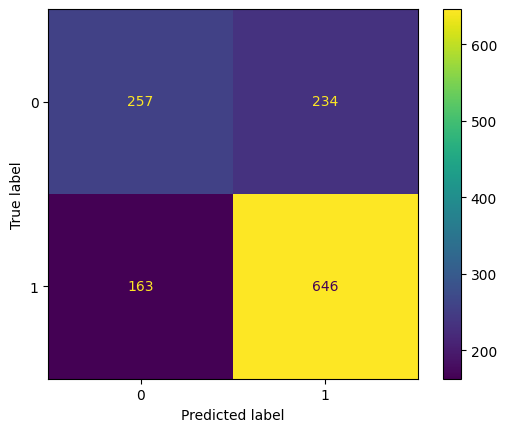

In [93]:
from sklearn.metrics import ConfusionMatrixDisplay
cm = confusion_matrix(y_test_binary, y_pred_binary)
cmd = ConfusionMatrixDisplay(cm, display_labels=gnb.classes_)
cmd.plot()

### Mejoramiento básico

In [102]:
gnb = GaussianNB(priors=[0.5, 0.5], var_smoothing=1e-9)
gnb.fit(X_train, y_train_binary)

c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GaussianNB(priors=[0.5, 0.5])

In [103]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
y_test_binary = np.where(y_test > mean_y_train, 1, 0)
y_pred_binary = gnb.predict(X_test)
accuracy_score(y_test_binary, y_pred_binary)
print(confusion_matrix(y_test_binary, y_pred_binary))
print(classification_report(y_test_binary, y_pred_binary))
print(accuracy_score(y_test_binary, y_pred_binary))

[[332 159]
 [236 573]]
              precision    recall  f1-score   support

           0       0.58      0.68      0.63       491
           1       0.78      0.71      0.74       809

    accuracy                           0.70      1300
   macro avg       0.68      0.69      0.69      1300
weighted avg       0.71      0.70      0.70      1300

0.6961538461538461


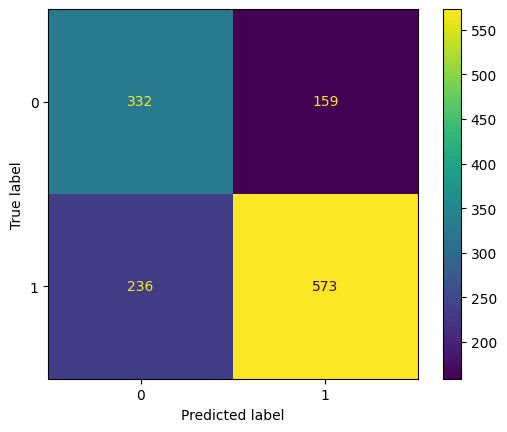

In [104]:
from sklearn.metrics import ConfusionMatrixDisplay
cm = confusion_matrix(y_test_binary, y_pred_binary)
cmd = ConfusionMatrixDisplay(cm, display_labels=gnb.classes_)
cmd.plot()

## Lineal
Debido a que tenemos un problema lineal sobre si el vino es bueno o no, es apropiado utilizar este modelo, además también nos otorgará información sobre la relevancia de las características del conjunto.

In [105]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [106]:
y_pred = lr.predict(X_test)
y_pred_orig = scalerY.inverse_transform(y_pred.reshape(-1, 1))
print(y_pred_orig)

[[5.85767972]
 [5.39559866]
 [6.0962993 ]
 ...
 [6.28472542]
 [5.65996814]
 [6.30887342]]


In [107]:
mean_squared_error(y_test, y_pred)

0.014730164567049597

In [110]:
wines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,type_red
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,False
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,False
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,False
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,False
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,False


### Se otienen los coeficientes para conocer que caraterísticas poseen un mayor peso

In [120]:
coeficientes = lr.coef_[0]
newWines = wines.drop(columns=['quality'])
for i in range(len(coeficientes)):
    print(f'{newWines.columns[i]}: {coeficientes[i]}')

fixed acidity: 0.18098029191048845
volatile acidity: -0.36971441998206445
citric acid: -0.035432571646636886
residual sugar: 0.6802262163668066
chlorides: -0.09269150176335475
free sulfur dioxide: 0.2639123401409886
total sulfur dioxide: -0.11717205445433951
density: -0.8467031284395659
pH: 0.0927881377770497
sulphates: 0.21252443220085765
alcohol: 0.26592840022615505
type_red: 0.060670590761031706


### Mejoramiento básico
No se encontraro parametros para un mejoramiento básico

In [142]:
lr = LinearRegression()
lr = lr.fit(X_train, y_train)

In [143]:
y_pred = lr.predict(X_test)
y_pred_orig = scalerY.inverse_transform(y_pred.reshape(-1, 1))
print(y_pred_orig)

[[5.85767972]
 [5.39559866]
 [6.0962993 ]
 ...
 [6.28472542]
 [5.65996814]
 [6.30887342]]


In [144]:
mean_squared_error(y_test, y_pred)

0.014730164567049597

# Validación cruzada y mejora de los modelos

In [150]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVR
import numpy as np

models_params = {
    LinearRegression(): {
        'fit_intercept': [True, False],
    },
    GaussianNB(): {
        'var_smoothing': [1e-9, 1e-8, 1e-7]
    },
    SVR(): {
        'C': [0.1, 1, 10],
        'kernel': ['linear', 'rbf']
    }
}

best_models = []
best_scores = []

for model, params in models_params.items():
    if isinstance(model, GaussianNB):
        mean_y = np.mean(y)
        y_binary = np.where(y > mean_y, 1, 0)
        grid_search = GridSearchCV(model, params, cv=5)
        grid_search.fit(X, y_binary)
    else:
        grid_search = GridSearchCV(model, params, cv=5)
        grid_search.fit(X, y)
    best_models.append(grid_search.best_estimator_)
    best_scores.append(grid_search.best_score_)

for i, model in enumerate(best_models):
    print(f"Model: {model}")
    print(f"Score: {best_scores[i]}\n")

c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Python311\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1

Model: LinearRegression()
Score: 0.2581653781501746

Model: GaussianNB()
Score: 0.6211959495469888

Model: SVR(C=1)
Score: 0.30464477800293044

